<a href="https://colab.research.google.com/github/EunSeong-Jo/2025-1-myclass-BDA/blob/main/stm_data.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

### 공공 데이터 분석

서울 교통수단 이동데이터

1. 비즈니스 이해

언제, 어디서, 어느 구간에서 혼잡이 집중되는가?

출/퇴근 시간대 주요 병목 구간은 어디인가?

분석 목표 : 정류장 간 출/퇴근 시간대 혼잡도를 <b>선그래프</b>와 <b>히트맵</b>으로 파악하여 혼잡 완화를 위한 인사이트 도출

---

2. 데이터 이해

| 파일명                                   | 데이터 의미                                      |
| ------------------------------------- | ----------------------------------------------- |
| DISTRICT\_EMD.csv                     | 행정동 코드와 명칭, 소속 구/시 데이터 |
| KSCC\_DV\_SUBWAY\_STATION\_GEOM.csv   | 지하철역 ID, 역명, 노선, 위치 데이터 |
| KSCC\_DX\_PATTERN\_STAT.csv           | 출근·퇴근·기타 등 패턴별, 날짜별·시간대별 통행량 데이터 |
| KSCC\_DX\_RA\_OD.csv                  | 정류장 간 OD(출발/도착) 통행량 데이터 |
| KSCC\_DX\_TRIP\_CHAIN\_SUM.csv        | 복합 이동 경로(환승) 요약 데이터 |
| KSCC\_DX\_TRNSF\_PATH\_SUM.csv        | 환승 구간/시간별 통계 데이터 |
| TBIS\_MS\_ROUTE.csv                   | 버스 노선 기본 데이터 |
| TBIS\_MS\_ROUTE\_NODE.csv             | 노선별 정류장 연결/순서 데이터 |
| ★ TBIS\_MS\_STTN.csv                    | 정류장 ID/명칭/위경도 데이터 |
| TB\_OPR\_STATION.csv                  | 운영 정류장 상세 주소와 좌표 데이터 |
| ★ TPSS\_A18\_ROUTE\_SECTION.csv         | 정류장 구간별, 시간대별 혼잡도(통행량) 데이터  |
| TPSS\_BCYCL\_OD\_STATN\_HM.csv        | 공유자전거 OD별 이용량 데이터 |
| TPSS\_EMD\_INFO\_H\_BUS.csv           | 행정동별 버스 시간대별 통계 데이터 |
| TPSS\_EMD\_INFO\_H\_PUBLIC.csv        | 행정동별 대중교통 전체 통계 데이터 |
| TPSS\_EMD\_INFO\_H\_SUBWAY.csv        | 행정동별 지하철 통계 데이터 |
| TPSS\_EMD\_OD\_H.csv                  | 동 간 시간대별 OD(출발/도착) 데이터 |
| TPSS\_EMD\_OD\_PS.csv                 | 동 간 일/누적 유동량 데이터 |
| TPSS\_EMD\_OD\_TC.csv                 | 구/동 명칭 기반 OD 데이터 |
| TPSS\_ROUTE\_SECTION\_SPEED\_H.csv    | 구간별 평균 속도와 시간별 데이터 |
| ★ TPSS\_STA\_ROUTE\_INFO\_H\_PASNGR.csv | 정류장/노선별 시간대별 승차량 데이터 |
| TPSS\_STA\_ROUTE\_INFO\_H\_TURN.csv   | 회차지점(회차, 환승지점) 통계 데이터 |

In [1]:
import pandas as pd

# 정류장 데이터, 정류장 간 이동(혼잡도) 데이터, 정류장 시간대별 승차량 데이터
df_TBIS = pd.read_csv("./STM_datasets/2025/202501/250101/TBIS_MS_STTN.csv")
df_TPSS_A18 = pd.read_csv("./STM_datasets/2025/202501/250101/TPSS_A18_ROUTE_SECTION.csv")
df_TPSS_H = pd.read_csv("./STM_datasets/2025/202501/250101/TPSS_STA_ROUTE_INFO_H_PASNGR.csv")

In [2]:
# 정류장 데이터 정보
df_TBIS.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63633 entries, 0 to 63632
Data columns (total 7 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   STTN_ID       63633 non-null  int64  
 1   STTN_NM       63633 non-null  object 
 2   STTN_TY       63633 non-null  object 
 3   STTN_NO       63628 non-null  float64
 4   CRDNT_X       63633 non-null  float64
 5   CRDNT_Y       63633 non-null  float64
 6   BIT_INSTL_AT  63633 non-null  object 
dtypes: float64(3), int64(1), object(3)
memory usage: 3.4+ MB


In [3]:
df_TBIS.head(3)

,STTN_ID,STTN_NM,STTN_TY,STTN_NO,CRDNT_X,CRDNT_Y,BIT_INSTL_AT
0,164000626,e편한세상 정문,일반차로,38624.0,126.614929,37.410124,미설치
1,164000627,송도파크레인동일하이빌,일반차로,38625.0,126.656706,37.402844,미설치
2,164000628,송도파크레인동일하이빌,일반차로,38626.0,126.656054,37.404317,미설치


In [4]:
# 정류장 간 이동(혼잡도) 데이터 정보
df_TPSS_A18.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37671 entries, 0 to 37670
Data columns (total 30 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   STDR_DE       37671 non-null  int64
 1   ROUTE_ID      37671 non-null  int64
 2   FROM_STTN_ID  37671 non-null  int64
 3   TO_STTN_ID    37671 non-null  int64
 4   STTN_SN       37671 non-null  int64
 5   CNT           37671 non-null  int64
 6   CNT_00H       37671 non-null  int64
 7   CNT_01H       37671 non-null  int64
 8   CNT_02H       37671 non-null  int64
 9   CNT_03H       37671 non-null  int64
 10  CNT_04H       37671 non-null  int64
 11  CNT_05H       37671 non-null  int64
 12  CNT_06H       37671 non-null  int64
 13  CNT_07H       37671 non-null  int64
 14  CNT_08H       37671 non-null  int64
 15  CNT_09H       37671 non-null  int64
 16  CNT_10H       37671 non-null  int64
 17  CNT_11H       37671 non-null  int64
 18  CNT_12H       37671 non-null  int64
 19  CNT_13H       37671 non-n

In [5]:
df_TPSS_A18.head(3)

,STDR_DE,ROUTE_ID,FROM_STTN_ID,TO_STTN_ID,STTN_SN,CNT,CNT_00H,CNT_01H,CNT_02H,CNT_03H,...,CNT_14H,CNT_15H,CNT_16H,CNT_17H,CNT_18H,CNT_19H,CNT_20H,CNT_21H,CNT_22H,CNT_23H
0,20250101,100100001,101000331,101000053,1,1122,0,0,0,0,...,141,153,89,87,63,45,27,11,2,0
1,20250101,100100001,101000053,101000054,2,1738,0,0,0,0,...,201,178,119,113,86,62,46,15,5,0
2,20250101,100100001,101000054,101000103,3,2745,0,0,0,0,...,331,259,228,173,122,117,58,29,10,0


In [6]:
# 정류장 시간대별 승차량 정보
df_TPSS_H.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90267 entries, 0 to 90266
Data columns (total 29 columns):
 #   Column    Non-Null Count  Dtype
---  ------    --------------  -----
 0   STDR_DE   90267 non-null  int64
 1   ROUTE_ID  90267 non-null  int64
 2   STTN_ID   90267 non-null  int64
 3   CNT       90267 non-null  int64
 4   CNT_00H   90267 non-null  int64
 5   CNT_01H   90267 non-null  int64
 6   CNT_02H   90267 non-null  int64
 7   CNT_03H   90267 non-null  int64
 8   CNT_04H   90267 non-null  int64
 9   CNT_05H   90267 non-null  int64
 10  CNT_06H   90267 non-null  int64
 11  CNT_07H   90267 non-null  int64
 12  CNT_08H   90267 non-null  int64
 13  CNT_09H   90267 non-null  int64
 14  CNT_10H   90267 non-null  int64
 15  CNT_11H   90267 non-null  int64
 16  CNT_12H   90267 non-null  int64
 17  CNT_13H   90267 non-null  int64
 18  CNT_14H   90267 non-null  int64
 19  CNT_15H   90267 non-null  int64
 20  CNT_16H   90267 non-null  int64
 21  CNT_17H   90267 non-null  int64
 22

In [7]:
df_TPSS_H.head(3)

,STDR_DE,ROUTE_ID,STTN_ID,CNT,CNT_00H,CNT_01H,CNT_02H,CNT_03H,CNT_04H,CNT_05H,...,CNT_15H,CNT_16H,CNT_17H,CNT_18H,CNT_19H,CNT_20H,CNT_21H,CNT_22H,CNT_23H,STTN_SN
0,20250101,100000017,101000308,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
1,20250101,100000017,101000309,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,2
2,20250101,100000017,101000310,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,3


In [8]:
import matplotlib.pyplot as plt

# 한글 폰트 설정
plt.rcParams['font.family'] = 'Malgun Gothic'
plt.rcParams['axes.unicode_minus'] = False

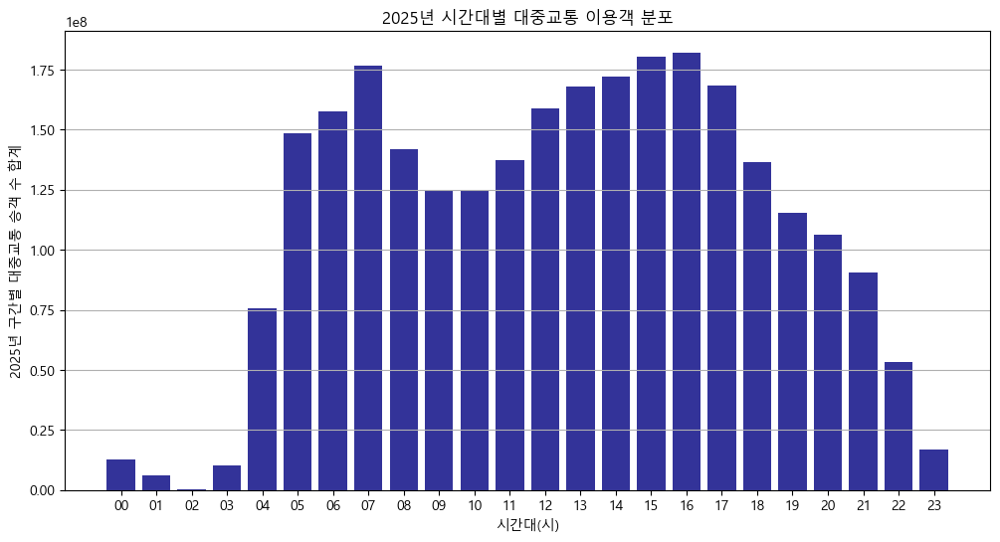

In [9]:
import os

dir_2025 = "C:/Users/asus/0528/STM_datasets/2025/"

route_list = []

# 혼잡도 데이터 읽어오기
for root, _, files in os.walk(dir_2025):
    for file in files:
        if file == "TPSS_A18_ROUTE_SECTION.csv":
            file_path = os.path.join(root, file)
            df = pd.read_csv(file_path, encoding="cp949")
            route_list.append(df)

# 2025년 모든 파일 누적 집계
df_all = pd.concat(route_list, ignore_index=True)

# 시간대 컬럼만 추출 (CNT_00H ~ CNT_23H)
hour_cols = [col for col in df_all.columns if col.startswith('CNT_') and col.endswith('H')]

# 시간대별 전체 승객 수 합산
hourly_sum = df_all[hour_cols].sum(axis=0)

# 시간대를 00~23시 정렬
hour_labels = [col.replace('CNT_','').replace('H','') for col in hour_cols]

plt.figure(figsize=(12,6))
plt.bar(hour_labels, hourly_sum, color='navy', alpha=0.8)
plt.xlabel("시간대(시)")
plt.ylabel("2025년 구간별 대중교통 승객 수 합계")
plt.title("2025년 시간대별 대중교통 이용객 분포")
plt.grid(axis='y')
plt.show()


3. 데이터 준비

##### cp949에서 utf-8로 인코딩 변경

In [ ]:
# 변환할 최상위 폴더 경로 입력
base_dir = "C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/"

for root, _, files in os.walk(base_dir):
    for file in files:
        if file.endswith(".csv"):
            file_path = os.path.join(root, file)
            try:
                # utf-8로 먼저 읽기
                df = pd.read_csv(file_path, encoding='utf-8', on_bad_lines='skip')
            except Exception as e1:
                try:
                    # 안 되면 cp949로 읽기
                    df = pd.read_csv(file_path, encoding='cp949', on_bad_lines='skip')
                except Exception as e2:
                    print(f"❌ 변환 실패: {file_path}, 사유: {e1}, {e2}")
                    continue
            try:
                # utf-8-sig로 **덮어쓰기**
                df.to_csv(file_path, index=False, encoding='utf-8-sig')
                print(f"✅ 덮어쓰기 변환 완료: {file_path}")
            except Exception as e:
                print(f"❌ 저장 실패: {file_path}, 사유: {e}")


✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\DISTRICT_EMD.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DV_SUBWAY_STATION_GEOM.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_PATTERN_STAT.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_RA_OD.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_TRIP_CHAIN_SUM.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\KSCC_DX_TRNSF_PATH_SUM.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TBIS_MS_ROUTE.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TBIS_MS_ROUTE_NODE.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TBIS_MS_STTN.csv
✅ 덮어쓰기 변환 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TB_OPR

In [ ]:
# TB_OPR_STATION.csv 파일 인코딩 변경오류 발생
# csv 마지막줄 " 추가로 오류 해결

base_dir = "C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/"

for root, _, files in os.walk(base_dir):
    for file in files:
        if file == "TB_OPR_STATION.csv":
            file_path = os.path.join(root, file)
            try:
                with open(file_path, "r", encoding="cp949", errors="replace") as f:
                    lines = f.readlines()
            except Exception as e:
                print(f"❌ 파일 열기 실패: {file_path}, 사유: {e}")
                continue

            if not lines[-1].rstrip().endswith('"'):
                lines[-1] = lines[-1].rstrip("\r\n") + '"\n'

                try:
                    with open(file_path, "w", encoding="utf-8", errors="replace") as f:
                        f.writelines(lines)
                    print(f'✅ 마지막 줄에 " 추가 완료: {file_path}')
                except Exception as e:
                    print(f'❌ 파일 저장 실패: {file_path}, 사유: {e}')
            else:
                print(f'⭕ 이미 정상: {file_path}')


✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250102\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250103\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250104\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250105\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250106\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250107\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250108\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250109\TB_OPR_STATION.csv
✅ 마지막 줄에 " 추가 완료: C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250110

##### 히트맵 출력을 위해 STTN_ID(정류장 ID) 기준으로 병합

In [ ]:
base_dir = "C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/"

for month in os.listdir(base_dir):
    month_path = os.path.join(base_dir, month)
    if not os.path.isdir(month_path): continue
    for day in os.listdir(month_path):
        day_path = os.path.join(month_path, day)
        if not os.path.isdir(day_path): continue

        # 정류장 정보와 시간대별 승하차 정보를 TBIS_TPSS_merge 파일로 통합
        sttn_path = os.path.join(day_path, "TBIS_MS_STTN.csv")
        cnt_path = os.path.join(day_path, "TPSS_STA_ROUTE_INFO_H_PASNGR.csv")
        output_path = os.path.join(day_path, "TBIS_TPSS_merge.csv")

        if os.path.isfile(sttn_path) and os.path.isfile(cnt_path):
            try:
                # utf-8로 읽기 (안 되면 cp949)
                try:
                    loc_df = pd.read_csv(sttn_path, encoding='utf-8')
                except Exception:
                    loc_df = pd.read_csv(sttn_path, encoding='cp949')

                try:
                    cnt_df = pd.read_csv(cnt_path, encoding='utf-8')
                except Exception:
                    cnt_df = pd.read_csv(cnt_path, encoding='cp949')

                # 컬럼명 정규화
                loc_df.columns = [c.upper().replace(" ", "").replace("-", "_") for c in loc_df.columns]
                cnt_df.columns = [c.upper().replace(" ", "").replace("-", "_") for c in cnt_df.columns]

                loc_cols = ['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y']
                cnt_cols = ['STTN_ID', 'CNT']
                if all(col in loc_df.columns for col in loc_cols) and all(col in cnt_df.columns for col in cnt_cols):
                    loc_df = loc_df[loc_cols]
                    cnt_df = cnt_df[cnt_cols]

                    # 병합 (STTN_ID 기준)
                    merged = pd.merge(loc_df, cnt_df, on='STTN_ID')
                    merged.dropna(subset=['CRDNT_X', 'CRDNT_Y', 'CNT'], inplace=True)
                    merged.to_csv(output_path, index=False, encoding='utf-8')
                    print(f"✅ [{day_path}] 병합 성공 (기준: STTN_ID, 행: {len(merged)})")
                else:
                    print(f"⚠️ [{day_path}] 컬럼 부족 또는 불일치")
            except Exception as e:
                print(f"❌ [{day_path}] 병합 실패: {e}")
        else:
            print(f"❌ [{day_path}] 위치 or 이용량 파일 없음")


✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250101] 병합 성공 (기준: STTN_ID, 행: 90077)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250102] 병합 성공 (기준: STTN_ID, 행: 91750)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250103] 병합 성공 (기준: STTN_ID, 행: 92199)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250104] 병합 성공 (기준: STTN_ID, 행: 90584)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250105] 병합 성공 (기준: STTN_ID, 행: 90844)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250106] 병합 성공 (기준: STTN_ID, 행: 91183)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250107] 병합 성공 (기준: STTN_ID, 행: 91675)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250108] 병합 성공 (기준: STTN_ID, 행: 91162)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250109] 병합 성공 (기준: STTN_ID, 행: 85654)
✅ [C:/Users/asus/2025-1-myclass-BDA/STM_datasets/2025/202501\250110] 병합 성공 (기준: STTN_ID, 행: 87480)
✅ [C:/User

4. 시각화

선 그래프 시각화

In [11]:
import folium
import numpy as np

base_dir = "C:/Users/asus/0528/STM_datasets/2025/"

route_list = []
sttn_info = None

for root, _, files in os.walk(base_dir):
    for file in files:
        # 혼잡도 데이터
        if file == "TPSS_A18_ROUTE_SECTION.csv":
            file_path = os.path.join(root, file)
            try:
                df = pd.read_csv(file_path, encoding="utf-8")
            except Exception:
                df = pd.read_csv(file_path, encoding="cp949")

            df['MORNING'] = df[['CNT_07H', 'CNT_08H', 'CNT_09H']].sum(axis=1)
            df['EVENING'] = df[['CNT_17H', 'CNT_18H', 'CNT_19H']].sum(axis=1)
            df['BOTH'] = df['MORNING'] + df['EVENING']  # 출근+퇴근 합계
            route_list.append(df[['FROM_STTN_ID', 'TO_STTN_ID', 'BOTH'] + [col for col in df.columns if col.startswith('CNT_')]])
        if sttn_info is None and file == "TBIS_MS_STTN.csv":
            file_path = os.path.join(root, file)
            try:
                sttn_info = pd.read_csv(file_path, encoding="utf-8")
            except Exception:
                sttn_info = pd.read_csv(file_path, encoding="cp949")

if not route_list or sttn_info is None:
    print("[2025] 유효한 데이터 없음")
else:
    # 누적 집계
    route_df = pd.concat(route_list, ignore_index=True).groupby(['FROM_STTN_ID', 'TO_STTN_ID']).sum(numeric_only=True).reset_index()

    # 정류장 좌표 merge
    sttn_info = sttn_info[['STTN_ID', 'CRDNT_X', 'CRDNT_Y']]
    route_df = route_df.merge(sttn_info, left_on='FROM_STTN_ID', right_on='STTN_ID', how='left')
    route_df = route_df.merge(sttn_info, left_on='TO_STTN_ID', right_on='STTN_ID', suffixes=('_FROM', '_TO'), how='left')

    # 합계 혼잡도 min/max
    both_max = route_df['BOTH'].max()
    both_min = route_df['BOTH'].min()

    m = folium.Map(location=[37.5665, 126.9780], zoom_start=11)

    # 선 그리기 (출퇴근 합산 혼잡도)
    for _, row in route_df.iterrows():
        if np.isnan(row['CRDNT_X_FROM']) or np.isnan(row['CRDNT_Y_FROM']) or \
           np.isnan(row['CRDNT_X_TO']) or np.isnan(row['CRDNT_Y_TO']):
            continue
        norm = (row['BOTH'] - both_min) / (both_max - both_min + 1e-9)
        color = plt.cm.Purples(norm)  # 출퇴근 합산은 보라색 계열 등 자유롭게
        color_hex = f"#{int(color[0]*255):02x}{int(color[1]*255):02x}{int(color[2]*255):02x}"
        weight = 1.5 + 6 * norm

        folium.PolyLine(
            locations=[
                [row['CRDNT_Y_FROM'], row['CRDNT_X_FROM']],
                [row['CRDNT_Y_TO'], row['CRDNT_X_TO']]
            ],
            color=color_hex,
            weight=weight,
            opacity=0.33 + 0.4 * norm,
            popup=f"출퇴근 합산 혼잡도: {int(row['BOTH']):,}"
        ).add_to(m)

    # 지도 바로 출력
    from IPython.display import display
    display(m)


##### 히트맵 시각화

In [ ]:
import folium
from folium.plugins import HeatMap

base_dir = "C:/Users/asus/0528/STM_datasets/2025/"
target_file = "TBIS_TPSS_merge.csv"

csv_files = []

# 날짜별 TBIS_TPSS_merge.csv만 수집
for root, _, files in os.walk(base_dir):
    if target_file in files:
        csv_files.append(os.path.join(root, target_file))

dfs = []
for file in csv_files:
    try:
        df = pd.read_csv(file, encoding='utf-8')
        dfs.append(df[['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y', 'CNT']])
    except Exception as e:
        print(f"읽기 실패: {file}, 이유: {e}")

if not dfs:
    print("유효한 데이터 없음")
else:
    merged = pd.concat(dfs, ignore_index=True)
    merged.dropna(subset=['CRDNT_X', 'CRDNT_Y', 'CNT'], inplace=True)
    grouped = merged.groupby(['STTN_ID', 'STTN_NM', 'CRDNT_X', 'CRDNT_Y'])['CNT'].sum().reset_index()

    # 지도 생성 및 히트맵 추가
    m = folium.Map(location=[37.5665, 126.9780], zoom_start=11)
    heat_data = [
        [row['CRDNT_Y'], row['CRDNT_X'], row['CNT']]
        for _, row in grouped.iterrows()
    ]
    HeatMap(
        heat_data,
        radius=15,
        blur=10,
        min_opacity=0.05,
        max_zoom=13
    ).add_to(m)

    from IPython.display import display
    display(m)

90개 TBIS_TPSS_merge.csv 파일 수집됨


5. 혼잡도 완화를 위한 정류장 시뮬레이션

가설 : 정류장 개수를 증가시키면 정류장 간 대기 인원이 분산되어 혼잡도가 완화되지 않을까?

In [12]:
import copy

# 가장 최신(2025년 3월 31일) 데이터 사용
sttn_path = "./STM_datasets/2025/202503/250331/TBIS_MS_STTN.csv"
merge_path = "./STM_datasets/2025/202503/250331/TBIS_TPSS_merge.csv"

df_sttn = pd.read_csv(sttn_path, encoding="utf-8")
df_merge = pd.read_csv(merge_path, encoding="utf-8")

base_stops = df_sttn['STTN_ID'].nunique()
base_congestion = list(df_merge.groupby('STTN_ID')['CNT'].sum())

# 1. 추가할 정거장 수, 승객 분산 비율 입력
increase = int(input(f"추가할 정거장 개수 : "))
percent = float(input("분산할 비율(%) : "))
print(f"추가된 정거장 수 : {increase}, 분산 비율 : {percent}%")

new_stops = base_stops + increase

# 2. 혼잡도가 높은 상위 10% 정거장 선정
top_n = max(1, int(base_stops * 0.1))
sorted_idx = np.argsort(base_congestion)[::-1]
top_idx = sorted_idx[:top_n]

# 3. 분산 (deepcopy로 원본 보존)
pre_congestion = copy.deepcopy(base_congestion)
transfer_total = 0
for i in top_idx:
    transfer = int(base_congestion[i] * (percent / 100))
    base_congestion[i] -= transfer
    transfer_total += transfer

# 4. 분산 승객을 신규 정거장에 균등 배분
added_congestion = [transfer_total // increase] * increase
for i in np.random.choice(range(increase), transfer_total % increase, replace=False):
    added_congestion[i] += 1

final_congestion = base_congestion + added_congestion

# --- 혼잡도 수치 비교 출력 ---
def show_stats(arr, label):
    print(f"\n {label}")
    print(f"  • 혼잡도 최대값: {np.max(arr):,}")
    print(f"  • 혼잡도 평균값: {np.mean(arr):,.1f}")

show_stats(pre_congestion, f"기존 {base_stops}개 정거장")
show_stats(final_congestion, f"신규 {new_stops}개 정거장 (혼잡 분산 후)")

추가된 정거장 수 : 100, 분산 비율 : 10.0%

 기존 63633개 정거장
  • 혼잡도 최대값: 11,546
  • 혼잡도 평균값: 217.0

 신규 63733개 정거장 (혼잡 분산 후)
  • 혼잡도 최대값: 10,392
  • 혼잡도 평균값: 216.1


In [13]:
# 가장 최신(2025년 3월 31일) 데이터 사용
sttn_path = "./STM_datasets/2025/202503/250331/TBIS_MS_STTN.csv"
merge_path = "./STM_datasets/2025/202503/250331/TBIS_TPSS_merge.csv"

df_sttn = pd.read_csv(sttn_path, encoding="utf-8")
df_merge = pd.read_csv(merge_path, encoding="utf-8")

base_stops = df_sttn['STTN_ID'].nunique()
base_congestion = list(df_merge.groupby('STTN_ID')['CNT'].sum())

# 1. 추가할 정거장 수, 승객 분산 비율 입력
increase = int(input(f"추가할 정거장 개수 : "))
percent = float(input("분산할 비율(%) : "))
print(f"추가된 정거장 수 : {increase}, 분산 비율 : {percent}%")

new_stops = base_stops + increase

# 2. 혼잡도가 높은 상위 10% 정거장 선정
top_n = max(1, int(base_stops * 0.1))
sorted_idx = np.argsort(base_congestion)[::-1]
top_idx = sorted_idx[:top_n]

# 3. 분산 (deepcopy로 원본 보존)
pre_congestion = copy.deepcopy(base_congestion)
transfer_total = 0
for i in top_idx:
    transfer = int(base_congestion[i] * (percent / 100))
    base_congestion[i] -= transfer
    transfer_total += transfer

# 4. 분산 승객을 신규 정거장에 균등 배분
added_congestion = [transfer_total // increase] * increase
for i in np.random.choice(range(increase), transfer_total % increase, replace=False):
    added_congestion[i] += 1

final_congestion = base_congestion + added_congestion

# --- 혼잡도 수치 비교 출력 ---
def show_stats(arr, label):
    print(f"\n {label}")
    print(f"  • 혼잡도 최대값: {np.max(arr):,}")
    print(f"  • 혼잡도 평균값: {np.mean(arr):,.1f}")

show_stats(pre_congestion, f"기존 {base_stops}개 정거장")
show_stats(final_congestion, f"신규 {new_stops}개 정거장 (혼잡 분산 후)")

추가된 정거장 수 : 1000, 분산 비율 : 10.0%

 기존 63633개 정거장
  • 혼잡도 최대값: 11,546
  • 혼잡도 평균값: 217.0

 신규 64633개 정거장 (혼잡 분산 후)
  • 혼잡도 최대값: 10,392
  • 혼잡도 평균값: 208.2


In [14]:
# 가장 최신(2025년 3월 31일) 데이터 사용
sttn_path = "./STM_datasets/2025/202503/250331/TBIS_MS_STTN.csv"
merge_path = "./STM_datasets/2025/202503/250331/TBIS_TPSS_merge.csv"

df_sttn = pd.read_csv(sttn_path, encoding="utf-8")
df_merge = pd.read_csv(merge_path, encoding="utf-8")

base_stops = df_sttn['STTN_ID'].nunique()
base_congestion = list(df_merge.groupby('STTN_ID')['CNT'].sum())

# 1. 추가할 정거장 수, 승객 분산 비율 입력
increase = int(input(f"추가할 정거장 개수 : "))
percent = float(input("분산할 비율(%) : "))
print(f"추가된 정거장 수 : {increase}, 분산 비율 : {percent}%")

new_stops = base_stops + increase

# 2. 혼잡도가 높은 상위 10% 정거장 선정
top_n = max(1, int(base_stops * 0.1))
sorted_idx = np.argsort(base_congestion)[::-1]
top_idx = sorted_idx[:top_n]

# 3. 분산 (deepcopy로 원본 보존)
pre_congestion = copy.deepcopy(base_congestion)
transfer_total = 0
for i in top_idx:
    transfer = int(base_congestion[i] * (percent / 100))
    base_congestion[i] -= transfer
    transfer_total += transfer

# 4. 분산 승객을 신규 정거장에 균등 배분
added_congestion = [transfer_total // increase] * increase
for i in np.random.choice(range(increase), transfer_total % increase, replace=False):
    added_congestion[i] += 1

final_congestion = base_congestion + added_congestion

# --- 혼잡도 수치 비교 출력 ---
def show_stats(arr, label):
    print(f"\n {label}")
    print(f"  • 혼잡도 최대값: {np.max(arr):,}")
    print(f"  • 혼잡도 평균값: {np.mean(arr):,.1f}")

show_stats(pre_congestion, f"기존 {base_stops}개 정거장")
show_stats(final_congestion, f"신규 {new_stops}개 정거장 (혼잡 분산 후)")

추가된 정거장 수 : 100, 분산 비율 : 30.0%

 기존 63633개 정거장
  • 혼잡도 최대값: 11,546
  • 혼잡도 평균값: 217.0

 신규 63733개 정거장 (혼잡 분산 후)
  • 혼잡도 최대값: 14,575
  • 혼잡도 평균값: 216.1


정류장을 100개를 추가했을 때와 1,000개를 추가했을 때 혼잡도의 변화가 미미함

분산의 비율을 높였을 때는 오히려 최대 혼잡도가 증가한 것으로 보았을 때 혼잡도 완화를 위해 정류장을 많이 만드는 것은 좋지 않을 해결법이라는 인사이트를 도출할 수 있었음